In [2]:
# 기본 데이터 정리 및 처리
import numpy as np
import pandas as pd
import scipy
from scipy import stats
import json
import sklearn
import re

# 시각화
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
plt.style.use('seaborn-whitegrid')
import missingno

from sklearn.metrics import roc_auc_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

import xgboost as xgb
from xgboost import plot_tree

# 전처리 및 머신 러닝 알고리즘
from sklearn.preprocessing import LabelEncoder, OneHotEncoder, OrdinalEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import VotingClassifier

# 모델 튜닝 및 평가
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_predict
from sklearn import model_selection
import pandas_profiling

# 경고 제거 (판다스가 에러 메세지를 자주 만들어 내기 때문에 이를 일단 무시하도록 설정합니다.)
import sys
import warnings
warnings.filterwarnings('ignore')

In [230]:
df_train_ = pd.read_csv("../input/restaurant-revenue-prediction/train.csv")
df_test_ = pd.read_csv("../input/restaurant-revenue-prediction/test.csv")

df_train = df_train_.copy()
df_train.head()

,Id,Open Date,City,City Group,Type,P1,P2,P3,P4,P5,...,P29,P30,P31,P32,P33,P34,P35,P36,P37,revenue
0,0,07/17/1999,İstanbul,Big Cities,IL,4,5.0,4.0,4.0,2,...,3.0,5,3,4,5,5,4,3,4,5653753.0
1,1,02/14/2008,Ankara,Big Cities,FC,4,5.0,4.0,4.0,1,...,3.0,0,0,0,0,0,0,0,0,6923131.0
2,2,03/09/2013,Diyarbakır,Other,IL,2,4.0,2.0,5.0,2,...,3.0,0,0,0,0,0,0,0,0,2055379.0
3,3,02/02/2012,Tokat,Other,IL,6,4.5,6.0,6.0,4,...,7.5,25,12,10,6,18,12,12,6,2675511.0
4,4,05/09/2009,Gaziantep,Other,IL,3,4.0,3.0,4.0,2,...,3.0,5,1,3,2,3,4,3,3,4316715.0


In [231]:
df_test_

,Id,Open Date,City,City Group,Type,P1,P2,P3,P4,P5,...,P28,P29,P30,P31,P32,P33,P34,P35,P36,P37
0,0,01/22/2011,Niğde,Other,FC,1,4.0,4.0,4.0,1,...,2.0,3.0,0,0,0,0,0,0,0,0
1,1,03/18/2011,Konya,Other,IL,3,4.0,4.0,4.0,2,...,1.0,3.0,0,0,0,0,0,0,0,0
2,2,10/30/2013,Ankara,Big Cities,FC,3,4.0,4.0,4.0,2,...,2.0,3.0,0,0,0,0,0,0,0,0
3,3,05/06/2013,Kocaeli,Other,IL,2,4.0,4.0,4.0,2,...,2.0,3.0,0,4,0,0,0,0,0,0
4,4,07/31/2013,Afyonkarahisar,Other,FC,2,4.0,4.0,4.0,1,...,5.0,3.0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
99995,99995,01/05/2000,Antalya,Other,FC,5,5.0,4.0,4.0,2,...,2.0,3.0,0,0,0,0,0,0,0,0
99996,99996,07/18/2011,Niğde,Other,IL,1,2.0,4.0,3.0,1,...,1.0,3.0,5,0,0,0,4,0,0,0
99997,99997,12/29/2012,İstanbul,Big Cities,IL,4,5.0,4.0,4.0,1,...,4.0,1.0,5,5,3,2,4,4,4,2
99998,99998,10/12/2013,İstanbul,Big Cities,FC,12,7.5,6.0,6.0,4,...,7.5,5.0,0,0,0,4,0,0,0,0


In [14]:
# df_train.profile_report()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [41]:
df_train['Open Date'].max()

Timestamp('2014-01-25 00:00:00')

In [69]:
df_train['City Group'].unique()

array(['Big Cities', 'Other'], dtype=object)

In [71]:
ohe = OneHotEncoder()
col_city_groups = ['city_group_'+str(i) for i in range(len(df_train['City Group'].unique()))]
pd.DataFrame(ohe.fit_transform(df_train[['City Group']]).toarray(), columns=col_city_groups)

,city_group_0,city_group_1
0,1.0,0.0
1,1.0,0.0
2,0.0,1.0
3,0.0,1.0
4,0.0,1.0
...,...,...
129,0.0,1.0
130,1.0,0.0
131,0.0,1.0
132,1.0,0.0


In [164]:
type1, type2 = df_train_['Type'].value_counts()[:2].index.tolist()
df_train['Type'] = [x if (x == type1) or (x == type2) else type1 for x in df_train['Type']]
df_train['Type'].unique()

array(['IL', 'FC'], dtype=object)

In [172]:
df_test = df_test_.copy()
df_test['Type'] = [x if (x == type1) or (x == type2) else type1 for x in df_test['Type']]
df_test['Type'].unique()

array(['FC', 'IL'], dtype=object)

In [267]:
class FeatureEngineering():
    def __init__(self, df_train_, df_test_):
        self.df_train = df_train_.copy()
        self.df_test = df_test_.copy()

        self.flag_preproc_type = False
        self.ohe_city_group = OneHotEncoder()
        self.ohe_type = OneHotEncoder()

    def proc_df(self):
        df_train, X_train, y_train = self.proc_train(self.df_train)
        X_test = self.proc_test(self.df_test)
        return df_train, X_train, y_train, X_test

    def proc_train(self, df):
        
        df = self.preproc_type(df)
        df = self.proc_date(df)
        df = df[df['revenue'] < 1e7]
        df = df.reset_index(drop=True)

        self.col_city_groups = ['city_group_'+str(i) for i in range(len(df['City Group'].unique()))]
        self.col_types = ['type_'+str(i) for i in range(len(df['Type'].unique()))]
        df_ohe_city_group = pd.DataFrame(self.ohe_city_group.fit_transform(df[['City Group']]).toarray(), columns=self.col_city_groups)
        df_ohe_type = pd.DataFrame(self.ohe_type.fit_transform(df[['Type']]).toarray(), columns=self.col_types)
        df_ohe_city_group = df_ohe_city_group.reset_index(drop=True)
        df_ohe_type = df_ohe_type.reset_index(drop=True)
        df = pd.concat([df, df_ohe_city_group, df_ohe_type], axis=1)

        df = self.del_columns(df)
        df = self.to_float(df)
        X_train = df.drop(['revenue'], axis=1)
        Y_train = df['revenue']

        return df, X_train, Y_train

    def proc_test(self, df):
        
        df = self.preproc_type(df)
        df = self.proc_date(df)
        df_ohe_city_group = pd.DataFrame(self.ohe_city_group.transform(df[['City Group']]).toarray(), columns=self.col_city_groups)
        df_ohe_type = pd.DataFrame(self.ohe_type.transform(df[['Type']]).toarray(), columns=self.col_types)
        df_ohe_city_group = df_ohe_city_group.reset_index(drop=True)
        df_ohe_type = df_ohe_type.reset_index(drop=True)

        df = pd.concat([df, df_ohe_city_group, df_ohe_type], axis=1)
        df = self.del_columns(df)
        df = self.to_float(df)
        X_test = df

        return X_test
    
    def del_columns(self, df):
        cols_to_del =['Id', 'City', 'City Group', 'Type'] 
        for col in cols_to_del:
            if col in df.columns:
                df = df.drop(col, axis=1)
        return df

    def preproc_type(self, df):
        # only top 2 items for column 'Type'
        if not self.flag_preproc_type:
            self.type1, self.type2 = df['Type'].value_counts()[:2].index.tolist()
            self.flag_preproc_type = True
        df['Type'] = [x if (x == type1) or (x == type2) else type1 for x in df['Type']]
        return df

    def proc_date(self, df):
        if 'Open Date' in df.columns:
            df['Open Date'] = pd.to_datetime(df['Open Date'])
            df['year'] = df['Open Date'].dt.year
            df['month'] = df['Open Date'].dt.month
            df['day'] = df['Open Date'].dt.day
            df['open_days'] = (df['Open Date'].max() - df['Open Date']).dt.days.astype(int)
            df = df.drop(['Open Date'], axis=1)
        return df
    
    def to_float(self, df):
        for col in df.columns:
            df[col] = df[col].astype(np.float64)
        return df
        

In [268]:
fe = FeatureEngineering(df_train_, df_test_)
df_train, X_train, y_train, X_test = fe.proc_df()


In [259]:
X_train.dtypes

P1              float64
P2              float64
P3              float64
P4              float64
P5              float64
P6              float64
P7              float64
P8              float64
P9              float64
P10             float64
P11             float64
P12             float64
P13             float64
P14             float64
P15             float64
P16             float64
P17             float64
P18             float64
P19             float64
P20             float64
P21             float64
P22             float64
P23             float64
P24             float64
P25             float64
P26             float64
P27             float64
P28             float64
P29             float64
P30             float64
P31             float64
P32             float64
P33             float64
P34             float64
P35             float64
P36             float64
P37             float64
year            float64
month           float64
day             float64
open_days       float64
city_group_0    

Text(0.5, 1.0, 'year vs count')

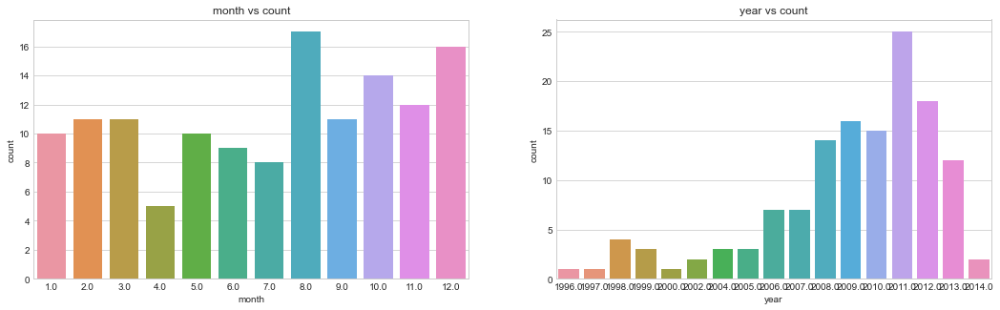

In [181]:
fig, axs = plt.subplots(1,2, figsize=(18,5))
sns.countplot(X_train['month'], ax=axs[0])
sns.countplot(X_train['year'], ax=axs[1])
axs[0].set_title('month vs count')
axs[1].set_title('year vs count')


In [182]:
X_train['open_days']

0      5306.0
1      2172.0
2       322.0
3       723.0
4      1722.0
        ...  
132    2040.0
133    2662.0
134    2758.0
135    1184.0
136    1607.0
Name: open_days, Length: 137, dtype: float64

<AxesSubplot:xlabel='open_days', ylabel='revenue'>

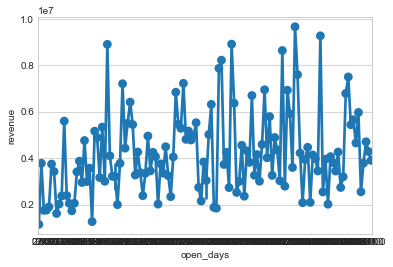

In [184]:
sns.pointplot(X_train['open_days'], y_train)

<AxesSubplot:xlabel='city_group_0', ylabel='revenue'>

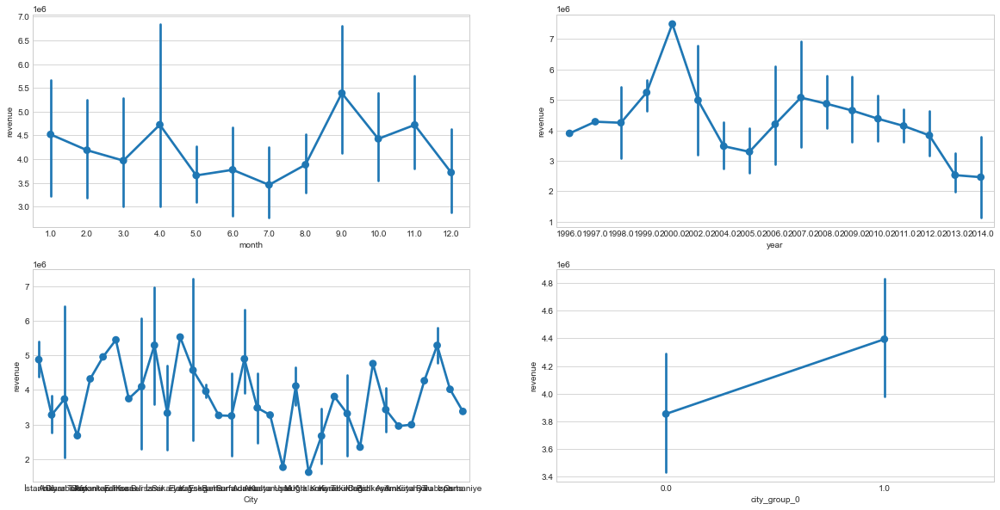

In [187]:
fig, axs = plt.subplots(2, 2, figsize=(20,10))
sns.pointplot(X_train['month'], y_train, ax=axs[0][0])
sns.pointplot(X_train['year'], y_train, ax=axs[0][1])
sns.pointplot(X_train['City'], y_train, ax=axs[1][0])
sns.pointplot(X_train['city_group_0'], y_train, ax=axs[1][1])

In [255]:
X_train.dtypes

P1                int64
P2              float64
P3              float64
P4              float64
P5                int64
P6                int64
P7                int64
P8                int64
P9                int64
P10               int64
P11               int64
P12               int64
P13             float64
P14               int64
P15               int64
P16               int64
P17               int64
P18               int64
P19               int64
P20               int64
P21               int64
P22               int64
P23               int64
P24               int64
P25               int64
P26             float64
P27             float64
P28             float64
P29             float64
P30               int64
P31               int64
P32               int64
P33               int64
P34               int64
P35               int64
P36               int64
P37               int64
year              int64
month             int64
day               int64
open_days         int32
city_group_0    

In [253]:
from pycaret.regression import *

In [269]:
df_train

,P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,...,P37,revenue,year,month,day,open_days,city_group_0,city_group_1,type_0,type_1
0,4.0,5.0,4.0,4.0,2.0,2.0,5.0,4.0,5.0,5.0,...,4.0,5653753.0,1999.0,7.0,17.0,5306.0,1.0,0.0,0.0,1.0
1,4.0,5.0,4.0,4.0,1.0,2.0,5.0,5.0,5.0,5.0,...,0.0,6923131.0,2008.0,2.0,14.0,2172.0,1.0,0.0,1.0,0.0
2,2.0,4.0,2.0,5.0,2.0,3.0,5.0,5.0,5.0,5.0,...,0.0,2055379.0,2013.0,3.0,9.0,322.0,0.0,1.0,0.0,1.0
3,6.0,4.5,6.0,6.0,4.0,4.0,10.0,8.0,10.0,10.0,...,6.0,2675511.0,2012.0,2.0,2.0,723.0,0.0,1.0,0.0,1.0
4,3.0,4.0,3.0,4.0,2.0,2.0,5.0,5.0,5.0,5.0,...,3.0,4316715.0,2009.0,5.0,9.0,1722.0,0.0,1.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129,2.0,3.0,3.0,5.0,4.0,2.0,4.0,4.0,4.0,4.0,...,0.0,5787594.0,2008.0,6.0,25.0,2040.0,0.0,1.0,1.0,0.0
130,4.0,5.0,4.0,4.0,2.0,3.0,5.0,4.0,4.0,5.0,...,0.0,9262754.0,2006.0,10.0,12.0,2662.0,1.0,0.0,1.0,0.0
131,3.0,4.0,4.0,4.0,2.0,3.0,5.0,5.0,5.0,5.0,...,0.0,2544857.0,2006.0,7.0,8.0,2758.0,0.0,1.0,1.0,0.0
132,4.0,5.0,4.0,5.0,2.0,2.0,5.0,5.0,5.0,5.0,...,0.0,7217634.0,2010.0,10.0,29.0,1184.0,1.0,0.0,1.0,0.0


In [271]:
exp = setup(data=df_train, target='revenue', session_id=123)

,Description,Value
0,session_id,123
1,Target,revenue
2,Original Data,"(134, 46)"
3,Missing Values,False
4,Numeric Features,41
5,Categorical Features,4
6,Ordinal Features,False
7,High Cardinality Features,False
8,High Cardinality Method,None
9,Transformed Train Set,"(93, 40)"


In [272]:
compare_models()

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE,TT (Sec)
et,Extra Trees Regressor,1375735.9391,2987101871280.6611,1664472.5002,-0.3055,0.3984,0.3822,0.0770
br,Bayesian Ridge,1467136.1099,3549870341799.0283,1809044.9766,-0.3940,0.4526,0.4389,0.0050
dummy,Dummy Regressor,1467136.1312,3549870397849.6001,1809044.9875,-0.3940,0.4526,0.4389,0.0050
ada,AdaBoost Regressor,1448016.4137,3321329296591.9434,1744546.9353,-0.5391,0.4178,0.4021,0.0150
en,Elastic Net,1615467.8312,3806249327001.6001,1879250.6250,-0.5771,0.4752,0.4648,0.0060
huber,Huber Regressor,1583714.4930,4212757245114.4482,1978427.0812,-0.6255,0.4793,0.4455,0.0070
omp,Orthogonal Matching Pursuit,1596817.5781,3845248872847.4360,1904474.8004,-0.6918,0.4625,0.4564,0.0050
rf,Random Forest Regressor,1460911.1544,3407297273139.5146,1787702.8645,-0.7136,0.4303,0.4147,0.0750
lightgbm,Light Gradient Boosting Machine,1511879.8222,3560247239264.0264,1834782.8575,-0.7205,0.4615,0.4284,0.0670
knn,K Neighbors Regressor,1613605.9625,4173381002854.3999,1984195.2875,-0.8823,0.4738,0.4471,0.0160


ExtraTreesRegressor(bootstrap=False, ccp_alpha=0.0, criterion='mse',
                    max_depth=None, max_features='auto', max_leaf_nodes=None,
                    max_samples=None, min_impurity_decrease=0.0,
                    min_impurity_split=None, min_samples_leaf=1,
                    min_samples_split=2, min_weight_fraction_leaf=0.0,
                    n_estimators=100, n_jobs=-1, oob_score=False,
                    random_state=123, verbose=0, warm_start=False)

In [273]:
et = create_model('et')

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,1571500.7170,3276785645878.0298,1810189.3950,0.2941,0.4515,0.4620
1,756588.9910,894852600090.3923,945966.4899,0.7258,0.2694,0.2327
2,1573424.3000,3007545063132.3530,1734227.5119,0.0452,0.5216,0.5794
3,1696887.7111,3413805501886.2969,1847648.6414,-0.0716,0.5063,0.5734
4,1505352.5067,2599440501654.8110,1612278.0473,-0.6019,0.4516,0.5229
5,1029176.4967,2565695646549.7490,1601778.9006,-0.2210,0.2743,0.1758
6,1111909.1289,2086948481370.8416,1444627.4542,0.0350,0.3545,0.2781
7,1021536.8578,1667168056889.8936,1291188.6217,-2.6559,0.3788,0.3760
8,2249792.6067,8049334773074.3389,2837134.9586,-0.0431,0.4808,0.3558


In [275]:
tuned_et = tune_model(et)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,1542508.8858,4253803055202.7017,2062474.9829,0.0836,0.4994,0.4606
1,1490096.7569,3151535137569.9629,1775256.3583,0.0343,0.4493,0.4103
2,1428449.6419,3422396796190.3018,1849972.1069,-0.0865,0.5398,0.5271
3,1568154.0090,3020209717277.8496,1737875.0580,0.0520,0.4636,0.4757
4,1165052.4222,1825717454634.2681,1351191.1244,-0.1251,0.4225,0.4409
5,1170919.3359,3509402522583.3926,1873339.9378,-0.6701,0.3441,0.1862
6,1226655.7701,1957637010029.1609,1399155.8205,0.0948,0.3609,0.3442
7,818349.7111,1229430031493.6338,1108796.6592,-1.6960,0.3460,0.3193
8,2711025.4932,10245266121144.4082,3200822.7257,-0.3277,0.5894,0.4808


In [285]:
lightgbm = create_model('lightgbm')
tuned_lightgbm = tune_model(lightgbm)

,MAE,MSE,RMSE,R2,RMSLE,MAPE
Fold,,,,,,
0,1582670.3176,3957620842688.5430,1989376.9986,0.1475,0.5300,0.5407
1,1377604.4974,2458765005317.2954,1568044.9628,0.2466,0.4313,0.4312
2,1423233.0780,2767987227970.6260,1663726.9091,0.1212,0.5209,0.5615
3,1598350.8763,2971108388514.6060,1723690.3401,0.0674,0.4859,0.5291
4,1414624.4854,2372184925836.1064,1540189.8993,-0.4619,0.4591,0.5106
5,982014.3556,2680223368797.5225,1637138.7751,-0.2755,0.2898,0.1569
6,1155267.6125,1980199005657.4180,1407195.4398,0.0843,0.3627,0.3371
7,1147929.5986,1971343382031.5625,1404045.3632,-3.3229,0.4087,0.4264
8,2449017.3096,8706704470481.5996,2950712.5361,-0.1283,0.5315,0.4376


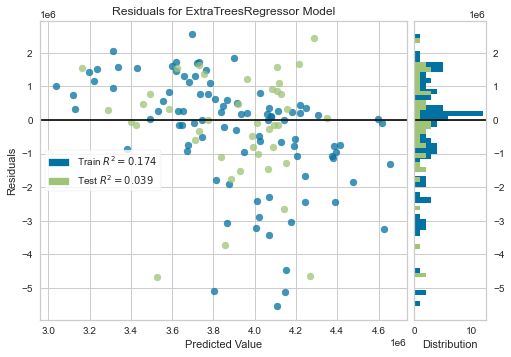

In [276]:
plot_model(tuned_et)

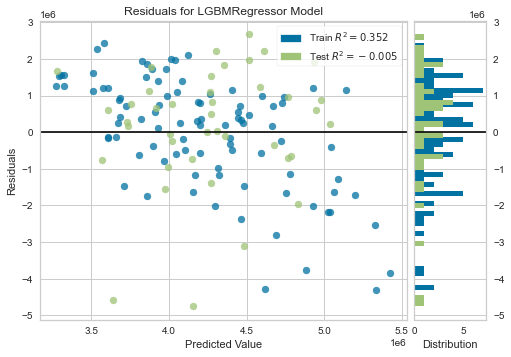

In [286]:
plot_model(tuned_lightgbm)

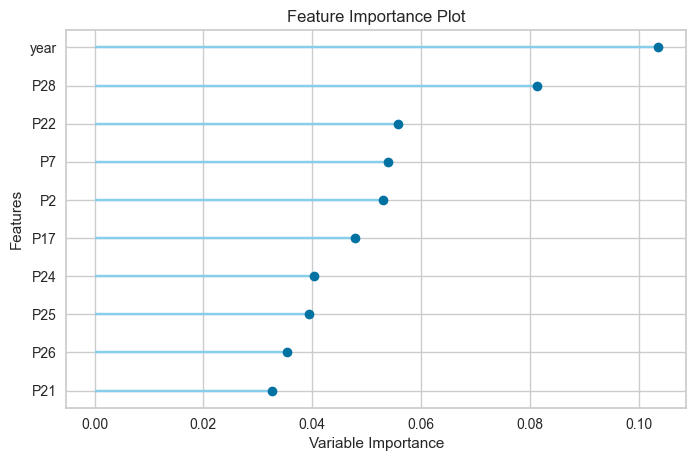

In [277]:
plot_model(tuned_et, plot='feature')

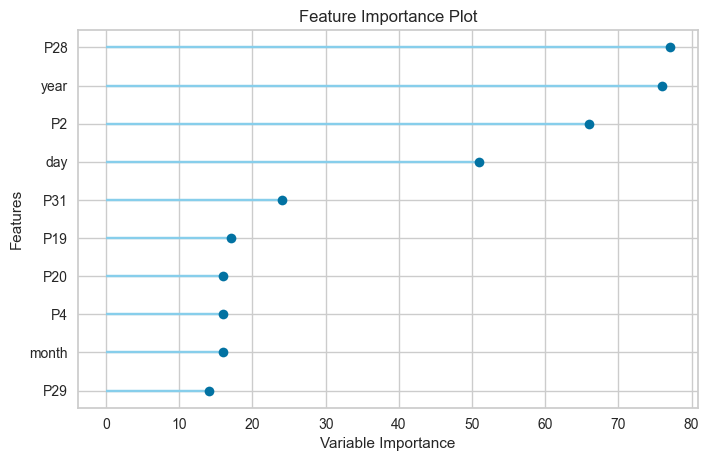

In [287]:
plot_model(tuned_lightgbm, plot='feature')

In [278]:
evaluate_model(tuned_et)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Hyperparameters', 'param…

In [279]:
predict_model(tuned_et);

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Extra Trees Regressor,1149501.9177,2556268880695.8345,1598833.6001,0.0394,0.3701,0.3043


In [288]:
predict_model(tuned_lightgbm);

,Model,MAE,MSE,RMSE,R2,RMSLE,MAPE
0,Light Gradient Boosting Machine,1227992.3561,2673952970754.6855,1635222.6059,-0.0048,0.3926,0.3517


In [280]:
unseen_predictions = predict_model(tuned_et, data=X_test)
unseen_predictions.head()

,P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,...,P37,year,month,day,open_days,city_group_0,city_group_1,type_0,type_1,Label
0,1.0,4.0,4.0,4.0,1.0,2.0,5.0,4.0,5.0,5.0,...,0.0,2011.0,1.0,22.0,1078.0,0.0,1.0,1.0,0.0,3.936555e+06
1,3.0,4.0,4.0,4.0,2.0,2.0,5.0,3.0,4.0,4.0,...,0.0,2011.0,3.0,18.0,1023.0,0.0,1.0,0.0,1.0,3.665431e+06
2,3.0,4.0,4.0,4.0,2.0,2.0,5.0,4.0,4.0,5.0,...,0.0,2013.0,10.0,30.0,66.0,1.0,0.0,1.0,0.0,3.824524e+06
3,2.0,4.0,4.0,4.0,2.0,3.0,5.0,4.0,5.0,4.0,...,0.0,2013.0,5.0,6.0,243.0,0.0,1.0,0.0,1.0,3.671250e+06
4,2.0,4.0,4.0,4.0,1.0,2.0,5.0,4.0,5.0,4.0,...,0.0,2013.0,7.0,31.0,157.0,0.0,1.0,1.0,0.0,3.874128e+06


In [289]:
unseen_predictions_lgbm = predict_model(tuned_lightgbm, data=X_test)
unseen_predictions_lgbm.head()

,P1,P2,P3,P4,P5,P6,P7,P8,P9,P10,...,P37,year,month,day,open_days,city_group_0,city_group_1,type_0,type_1,Label
0,1.0,4.0,4.0,4.0,1.0,2.0,5.0,4.0,5.0,5.0,...,0.0,2011.0,1.0,22.0,1078.0,0.0,1.0,1.0,0.0,4.297202e+06
1,3.0,4.0,4.0,4.0,2.0,2.0,5.0,3.0,4.0,4.0,...,0.0,2011.0,3.0,18.0,1023.0,0.0,1.0,0.0,1.0,3.950905e+06
2,3.0,4.0,4.0,4.0,2.0,2.0,5.0,4.0,4.0,5.0,...,0.0,2013.0,10.0,30.0,66.0,1.0,0.0,1.0,0.0,3.605199e+06
3,2.0,4.0,4.0,4.0,2.0,3.0,5.0,4.0,5.0,4.0,...,0.0,2013.0,5.0,6.0,243.0,0.0,1.0,0.0,1.0,3.556225e+06
4,2.0,4.0,4.0,4.0,1.0,2.0,5.0,4.0,5.0,4.0,...,0.0,2013.0,7.0,31.0,157.0,0.0,1.0,1.0,0.0,3.824025e+06


In [283]:
df_submission = pd.read_csv('../input/restaurant-revenue-prediction/sampleSubmission.csv')
df_submission['Prediction'] = unseen_predictions['Label']

In [291]:
df_submission.to_csv('../output/restaurant_revenue_prediction.csv', index=False)

In [292]:
df_submission = pd.read_csv('../input/restaurant-revenue-prediction/sampleSubmission.csv')
df_submission['Prediction'] = unseen_predictions_lgbm['Label']
df_submission.to_csv('../output/restaurant_revenue_prediction.csv', index=False)